<a href="https://colab.research.google.com/github/ElizabethSpinoso/Inteligencia-Artificial-y-Redes-Neuronales-/blob/main/Proyecto%20Final/PIA_FRUIT_CLASIFICATOR_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**1. Cargar librerías**

In [ ]:
import tensorflow as tf
from tensorflow.keras import datasets, layers, models
import matplotlib.pyplot as plt

**2. Cargar datos**

In [ ]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("karimabdulnabi/fruit-classification10-class")

print("Path to dataset files:", path)

100%|██████████| 29.2M/29.2M [00:00<00:00, 64.3MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/karimabdulnabi/fruit-classification10-class/versions/1


In [ ]:
!pip install kaggle
from google.colab import files

In [ ]:
files.upload()

Saving DATASET FRUIT.zip to DATASET FRUIT.zip


{'DATASET FRUIT.zip': b'PK\x03\x04\x14\x00\x00\x00\x00\x00x\xa2q[\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x0e\x00 \x00DATASET FRUIT/ux\x0b\x00\x01\x04\x00\x00\x00\x00\x04\x00\x00\x00\x00UT\r\x00\x07\xc4\xd7\x1bi3\xf9\x1ci\xb9\xd7\x1biPK\x03\x04\x14\x00\x00\x00\x00\x00\x01\xa2q[\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x16\x00 \x00DATASET FRUIT/PREDICT/ux\x0b\x00\x01\x04\x00\x00\x00\x00\x04\x00\x00\x00\x00UT\r\x00\x07\xe3\xd6\x1bi3\xf9\x1ci\x8c\xd6\x1biPK\x03\x04\x14\x00\x08\x00\x08\x00\x01\xa2q[\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x1c\x00 \x00DATASET FRUIT/PREDICT/0.jpegux\x0b\x00\x01\x04\x00\x00\x00\x00\x04\x00\x00\x00\x00UT\r\x00\x07\xe3\xd6\x1biy\xf8\x1ci\x1e+\x1ci\x9dyeP\x1cL\xb4\xe5\xa0\x03\x04\x0f$\xb8;\xc1\xddC\x082\x90@\x18\x18\xdc\x82\xbb\xbbK a\x82\x1348\x83\x0c2\x13\\\x82\x06\x06wKp2@p\x97\xe0\xec\xf7\xed{\xbb[\xfb\xea\xfd\xd9=]\xe7\xd7\xb9}\xee\xad[\xd5U\xdd\xb7\x1f\x7f=\xae\x01H\xd5U@*\x00\x0c\x0c\x00\x00\xe3\x9f\x05x\\\x04(\x01\xf0pq\x81\xb88x@ 

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

cp: cannot stat 'kaggle.json': No such file or directory
chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
!kaggle datasets download -d karimabdulnabi/fruit-classification10-class

Traceback (most recent call last):
  File "/usr/local/bin/kaggle", line 10, in <module>
    sys.exit(main())
             ^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/kaggle/cli.py", line 68, in main
    out = args.func(**command_args)
          ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/kaggle/api/kaggle_api_extended.py", line 1741, in dataset_download_cli
    with self.build_kaggle_client() as kaggle:
         ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/kaggle/api/kaggle_api_extended.py", line 688, in build_kaggle_client
    username=self.config_values['username'],
             ~~~~~~~~~~~~~~~~~~^^^^^^^^^^^^
KeyError: 'username'


In [ ]:
import zipfile

# Ruta al archivo ZIP descargado
zip_file_path = '/content/DATASET FRUIT.zip'

# Ruta a la carpeta donde deseas descomprimir el archivo
extracted_folder_path = '/content/Dataset'

with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extracted_folder_path)

In [ ]:
imagenes = []
etiquetas = []

In [ ]:
import os
import glob
import cv2
import numpy as np

# Clear existing data to prevent accumulation on re-run
imagenes = []
etiquetas = []

# Base path to the dataset
base_dataset_path = '/content/Dataset/DATASET FRUIT'

# Define the directories containing the images (e.g., TRAIN, TEST)
data_subdirs = ['TRAIN', 'TEST']

# Map class names to integer labels
class_names = []

# Iterate through each data subdirectory (TRAIN, TEST)
current_label = 0
for data_subdir in data_subdirs:
    full_data_path = os.path.join(base_dataset_path, data_subdir)

    # Get all class subdirectories within TRAIN or TEST
    class_subdirs = [d for d in os.listdir(full_data_path) if os.path.isdir(os.path.join(full_data_path, d))]

    for class_name_full in class_subdirs:
        # Extract a cleaner class name, e.g., 'Strawberry' from 'Strawberry 224x224 TR'
        clean_class_name = class_name_full.split(' ')[0] # Takes 'Strawberry' from 'Strawberry 224x224 TR'

        # Assign a new label if this class hasn't been seen before
        if clean_class_name not in class_names:
            class_names.append(clean_class_name)

        # Get the integer label for this class
        label = class_names.index(clean_class_name)

        class_path = os.path.join(full_data_path, class_name_full)
        print(f'Processing images in: {class_path} (Label: {label}, Class: {clean_class_name})')

        # Iterate through all JPEG images in the current class directory
        for image_path in glob.iglob(f'{class_path}/*.jpeg'):
            test_image = cv2.imread(image_path)
            if test_image is not None:
                img_resized = cv2.resize(test_image, (224, 224))
                arreglo_imagen = np.array(img_resized)
                imagenes.append(arreglo_imagen)
                etiquetas.append(label)
            else:#
                print(f"Warning: Could not load image {image_path}")

print(f"Total images loaded: {len(imagenes)}")
print(f"Total labels loaded: {len(etiquetas)}")
print(f"Detected classes: {class_names}")

Processing images in: /content/Dataset/DATASET FRUIT/TRAIN/Orange 224x224 (Label: 0, Class: Orange)
Processing images in: /content/Dataset/DATASET FRUIT/TRAIN/Apple 224x224 (Label: 1, Class: Apple)
Processing images in: /content/Dataset/DATASET FRUIT/TRAIN/Strawberry 224x224 (Label: 2, Class: Strawberry)
Processing images in: /content/Dataset/DATASET FRUIT/TEST/Orange 224x224 (Label: 0, Class: Orange)
Processing images in: /content/Dataset/DATASET FRUIT/TEST/Apple 224x224 (Label: 1, Class: Apple)
Processing images in: /content/Dataset/DATASET FRUIT/TEST/Strawberry 224x224 (Label: 2, Class: Strawberry)
Total images loaded: 949
Total labels loaded: 949
Detected classes: ['Orange', 'Apple', 'Strawberry']


In [ ]:
from sklearn.model_selection import train_test_split
import numpy as np # Import numpy if not already imported in this scope

images = np.array(imagenes)
etiquetas = np.array(etiquetas)

train_images, test_images, train_labels, test_labels = train_test_split(images, etiquetas, test_size=0.2, random_state=42)

train_images = train_images / 255.0
test_images = test_images / 255.0

In [ ]:
etiquetas = np.array(etiquetas)

In [ ]:
images = np.array(imagenes)

In [ ]:
np.shape(images)

(949, 224, 224, 3)

In [ ]:
len(etiquetas)

949

In [ ]:
etiquetas[-1]

np.int64(2)

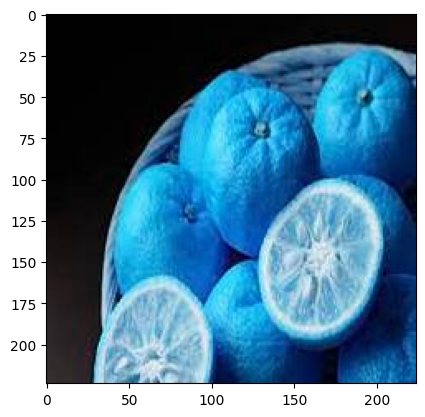

In [ ]:
plt.imshow(imagenes[0])

In [ ]:

# Convierte la imagen en un arreglo de numpy
arreglo_imagen = np.array(img_resized)
imagenes.append(arreglo_imagen)

In [ ]:

import tensorflow as tf
from tensorflow.keras import datasets, layers, models
import matplotlib.pyplot as plt


In [ ]:
import tensorflow as tf
from tensorflow.keras import datasets, layers, models
import matplotlib.pyplot as plt

# The class_names are already defined in cell PYzEy3_8J8gh
# We will reuse that variable for consistency and correct labels.
# If you run this cell independently, ensure `class_names` is populated correctly
# from the image loading step.


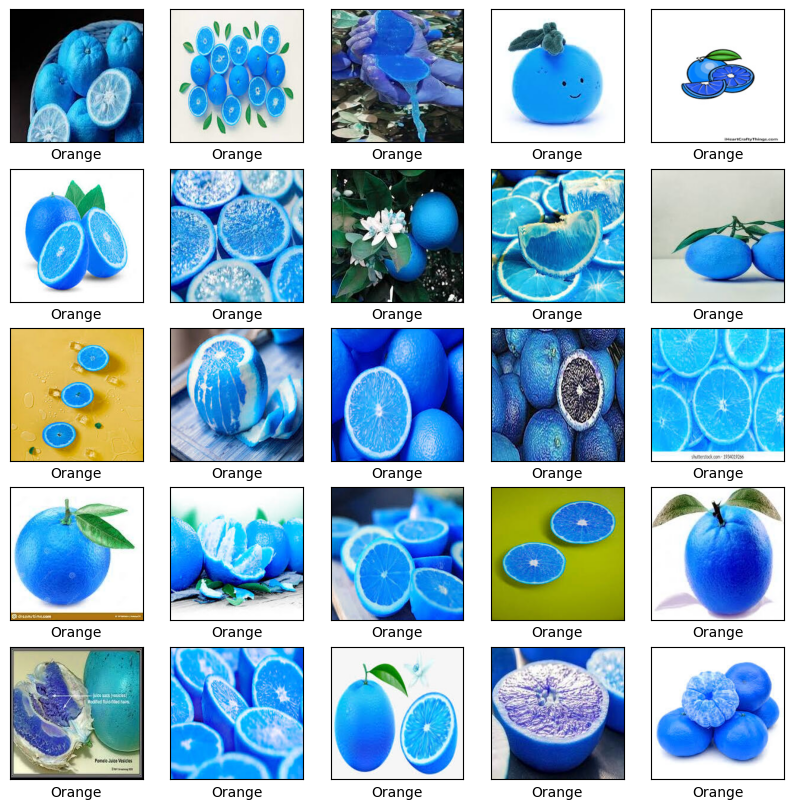

In [ ]:
plt.figure(figsize=(10,10))
for i in range(len(images)):
    if i >= 25: # Only plot the first 25 images to avoid excessive output
        break
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(images[i])
    # Ensure the label index is within the bounds of class_names
    if etiquetas[i] < len(class_names):
        plt.xlabel(class_names[etiquetas[i]])
    else:
        plt.xlabel(f'Unknown Label: {etiquetas[i]}')
plt.show()

**3. Model Creation**

In [ ]:
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu', input_shape=(224, 224, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))

/usr/local/lib/python3.12/dist-packages/keras/src/layers/convolutional/base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [ ]:
model.add(layers.Flatten())
model.add(layers.Dense(64, activation='relu'))
#model.add(layers.Dropout(0.5)) # Add dropout layer with 50% dropout rate
model.add(layers.Dense(len(class_names)))

In [ ]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 222, 222, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 111, 111, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 109, 109, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 54, 54, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 52, 52, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 173056)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 64)             │    11,075,648 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 3)              │           195 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 11,132,163 (42.47 MB)

 Trainable params: 11,132,163 (42.47 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

history = model.fit(train_images, train_labels, epochs=10,
                    validation_data=(test_images, test_labels))

Epoch 1/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 89s 4s/step - accuracy: 0.3976 - loss: 3.4638 - val_accuracy: 0.5158 - val_loss: 0.8618
Epoch 2/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 79s 3s/step - accuracy: 0.5662 - loss: 0.8454 - val_accuracy: 0.5579 - val_loss: 0.8103
Epoch 3/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 81s 3s/step - accuracy: 0.7339 - loss: 0.6875 - val_accuracy: 0.8053 - val_loss: 0.4377
Epoch 4/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 77s 3s/step - accuracy: 0.8845 - loss: 0.3491 - val_accuracy: 0.8895 - val_loss: 0.3043
Epoch 5/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 83s 3s/step - accuracy: 0.9039 - loss: 0.2535 - val_accuracy: 0.9158 - val_loss: 0.2170
Epoch 6/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 81s 3s/step - accuracy: 0.9365 - loss: 0.1896 - val_accuracy: 0.8789 - val_loss: 0.2879
Epoch 7/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 85s 3s/step - accuracy: 0.9173 - loss: 0.2006 - val_accuracy: 0.8947 - val_loss: 0.3009
Epoch 8/10
24/24 ━━━━━━━━━━━━━━━━━━━━ 88s 4s/step - accuracy: 0.9384 - loss: 0.1568 - val_accuracy: 0.9105 - val_loss:

**4. Evaluate the Model**

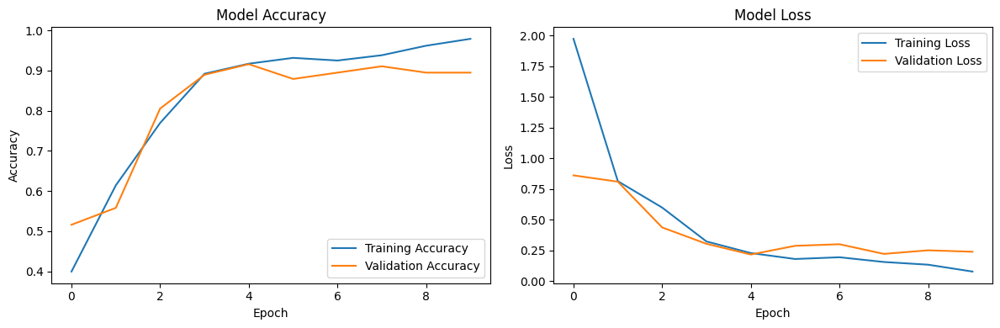

In [ ]:
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='lower right')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show()

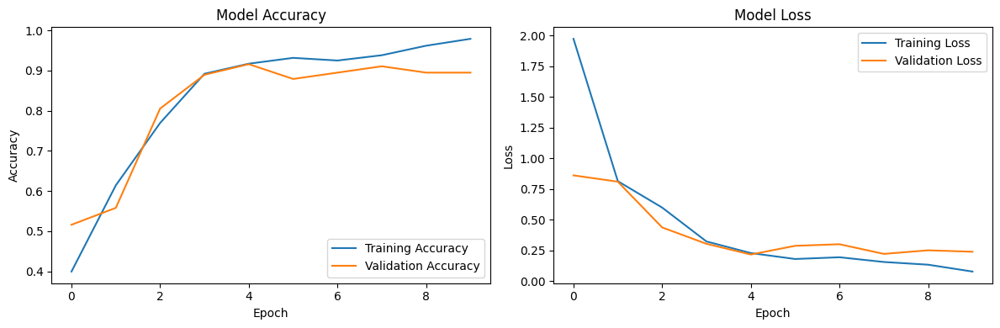

In [ ]:
plt.figure(figsize=(12, 4))

# Plot training & validation accuracy values
plt.subplot(1, 2, 1)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='lower right')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(loc='upper right')

plt.tight_layout()
plt.show()

In [ ]:
probability_model = tf.keras.Sequential([model, tf.keras.layers.Softmax()])
predictions = probability_model.predict(test_images)

6/6 ━━━━━━━━━━━━━━━━━━━━ 5s 887ms/step


In [ ]:
predictions[0]

array([9.9999148e-01, 8.4704634e-06, 2.7413714e-11], dtype=float32)

In [ ]:
import cv2 # Ensure cv2 is imported for cvtColor

def plot_image(i, predictions_array, true_label, img):
  true_label, img = true_label[i], img[i]
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])

  # Convert the float64 image (0-1) to uint8 (0-255) for cv2.cvtColor
  img_uint8 = (img * 255).astype(np.uint8)
  # Convert BGR to RGB for correct color display with matplotlib
  img_rgb = cv2.cvtColor(img_uint8, cv2.COLOR_BGR2RGB)
  plt.imshow(img_rgb)

  predicted_label = np.argmax(predictions_array)
  if predicted_label == true_label:
    color = 'green'
  else:
    color = 'red'

  plt.xlabel("{} {:2.0f}% ({})".format(class_names[predicted_label],
                                100*np.max(predictions_array),
                                class_names[true_label]),
                                color=color)

def plot_value_array(i, predictions_array, true_label):
  true_label = true_label[i]
  plt.grid(False)
  plt.xticks(range(len(predictions_array)))
  plt.yticks([])
  thisplot = plt.bar(range(len(predictions_array)), predictions_array, color="#777777")
  plt.ylim([0, 1])
  predicted_label = np.argmax(predictions_array)

  thisplot[predicted_label].set_color('red')
  thisplot[true_label].set_color('green')

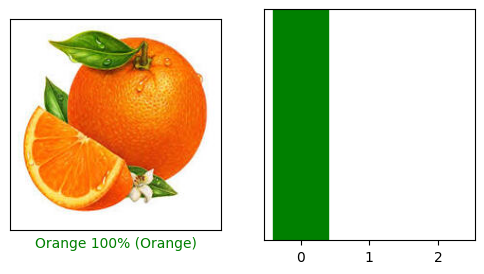

In [ ]:
i = 0
plt.figure(figsize=(6,3))
plt.subplot(1,2,1)
plot_image(i, predictions[i], test_labels, test_images)
plt.subplot(1,2,2)
plot_value_array(i, predictions[i],  test_labels)
plt.show()

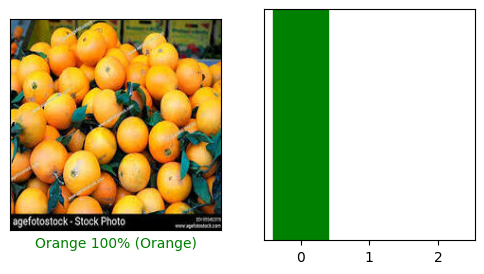

In [ ]:
i = 150
plt.figure(figsize=(6,3))
plt.subplot(1,2,1)
plot_image(i, predictions[i], test_labels, test_images)
plt.subplot(1,2,2)
plot_value_array(i, predictions[i],  test_labels)
plt.show()

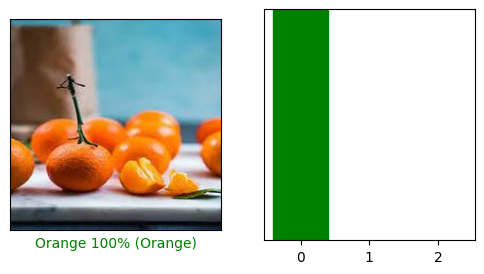

In [ ]:
i = 23
plt.figure(figsize=(6,3))
plt.subplot(1,2,1)
plot_image(i, predictions[i], test_labels, test_images)
plt.subplot(1,2,2)
plot_value_array(i, predictions[i],  test_labels)
plt.show()

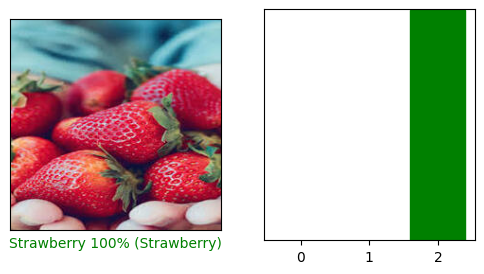

In [ ]:
i = 84
plt.figure(figsize=(6,3))
plt.subplot(1,2,1)
plot_image(i, predictions[i], test_labels, test_images)
plt.subplot(1,2,2)
plot_value_array(i, predictions[i],  test_labels)
plt.show()

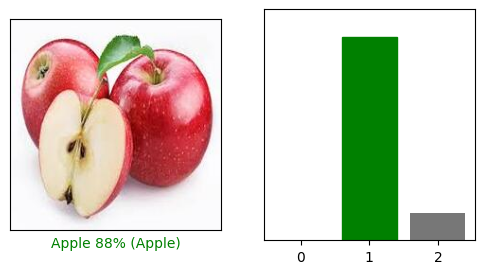

In [ ]:
i = 93
plt.figure(figsize=(6,3))
plt.subplot(1,2,1)
plot_image(i, predictions[i], test_labels, test_images)
plt.subplot(1,2,2)
plot_value_array(i, predictions[i],  test_labels)
plt.show()

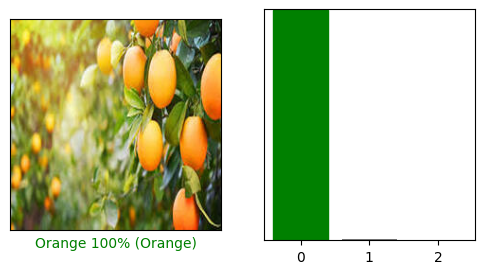

In [ ]:
i = 3
plt.figure(figsize=(6,3))
plt.subplot(1,2,1)
plot_image(i, predictions[i], test_labels, test_images)
plt.subplot(1,2,2)
plot_value_array(i, predictions[i],  test_labels)
plt.show()

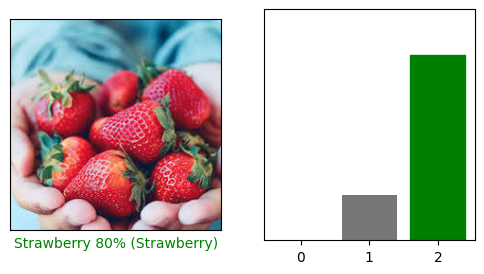

In [ ]:
i = 180
plt.figure(figsize=(6,3))
plt.subplot(1,2,1)
plot_image(i, predictions[i], test_labels, test_images)
plt.subplot(1,2,2)
plot_value_array(i, predictions[i],  test_labels)
plt.show()

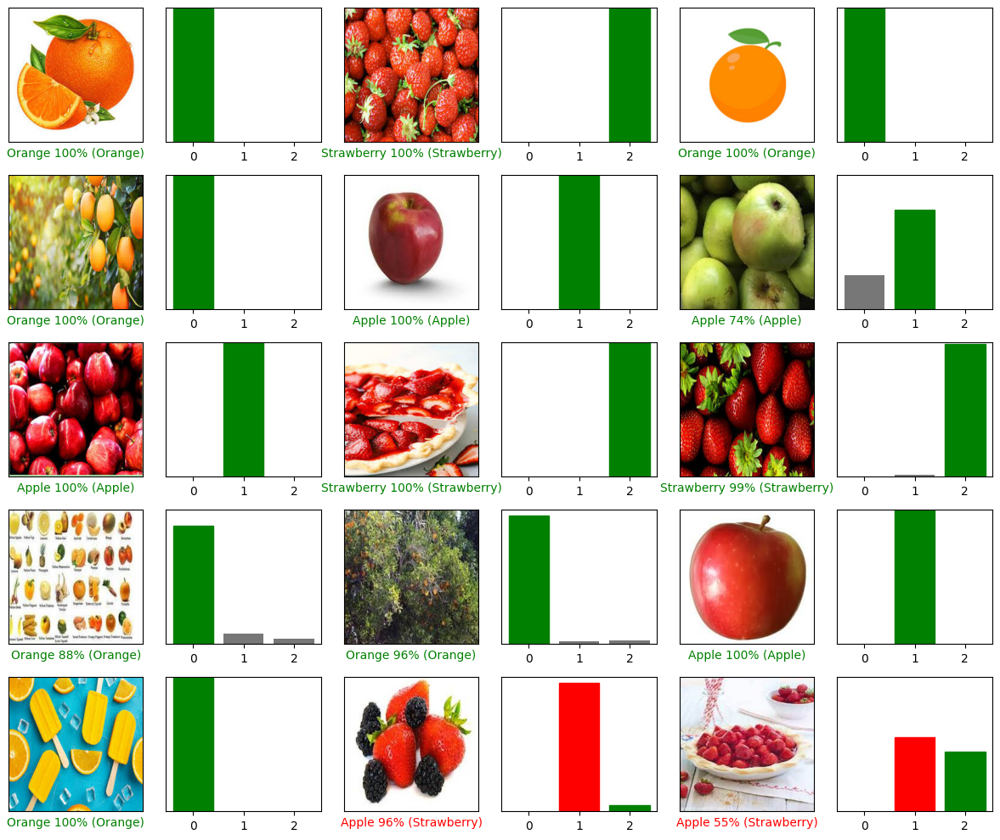

In [ ]:
# Plot the first X test images, their predicted labels, and the true labels.
# Color correct predictions in blue and incorrect predictions in red.
num_rows = 5
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(2*2*num_cols, 2*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_image(i, predictions[i], test_labels, test_images)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_value_array(i, predictions[i], test_labels)
plt.tight_layout()
plt.show()